# Photometric Stereo

The next cell loads 7 image sequences named

1. *chrome*,
2. *buddha*,
3. *cat*,
4. *gray*,
5. *owl*,
6. *rock*, and
7. *horse*.

from `demoImages.zip`.  Each sequence has 12 images of an object (e.g. *budda*) taken under different illuminations, and the goal of this project is to reconstruct the surface normals of these objects by photometric stereo.

First upload `demoImages.zip` using the Colaboratory File Browser in the left pane, and then run the cell below.  It will load images into the following three dictionaries

* `bgr`: original BGR image,
* `gray`: grayscale version, and
* `mask`: binary image indicating the target region in the image.

For example, `bgr['budda'][0]` is the first image of *budda* sequence, given as $340{\times}512{\times}3$ `numpy.ndarray`. In other words, `bgr['budda']` is a set of images in NHWC format.


bgr: (12, 340, 512, 3)
gray: (12, 340, 512)
mask: (340, 512)
budda sequence


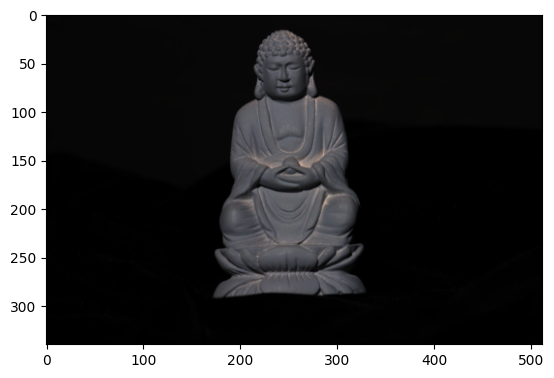

In [1]:
#@title Load Images
ZIP_FILE_NAME = "demoImages.zip" #@param {type:"string"}

import numpy as np
import scipy.sparse as sp
import scipy.sparse.linalg
from matplotlib import rc
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import cv2
import zipfile
import os


rc('animation', html='jshtml')

def imread_z(zf, filename, flag=cv2.IMREAD_UNCHANGED):
    return cv2.imdecode(np.frombuffer(zf.read(filename), dtype='uint8'), flag)

Ni = 12
SUBJECT = ['chrome', 'buddha', 'cat', 'gray', 'owl', 'rock', 'horse', ]
bgr = {}
gray = {}
mask = {}

# check if the zip exists
assert os.path.exists(ZIP_FILE_NAME), 'Upload %s via Colab File Browser and then re-run the cell.' % ZIP_FILE_NAME

# load images from the zip
with zipfile.ZipFile(ZIP_FILE_NAME, mode='r') as zf:
    for s in SUBJECT:
        bgr[s] = np.array([imread_z(zf, '{0}/{0}.{1:d}.png'.format(s, x)) for x in range(Ni)])
        gray[s] = np.array([imread_z(zf, '{0}/{0}.{1:d}.png'.format(s, x), cv2.IMREAD_GRAYSCALE) for x in range(Ni)])
        mask[s] = imread_z(zf, '{0}/{0}.mask.png'.format(s), cv2.IMREAD_GRAYSCALE)


# check the size of a sequence
print('bgr:', bgr['chrome'].shape)
print('gray:', gray['chrome'].shape)
print('mask:', mask['chrome'].shape)

# show budda images by animation
print('budda sequence')
tmp = bgr['buddha']
fig = plt.figure()
ani = animation.ArtistAnimation(fig, [[plt.imshow(cv2.cvtColor(tmp[i], cv2.COLOR_BGR2RGB), animated=True)] for i in range(tmp.shape[0])], interval=100, blit=True, repeat_delay=1000)
ani

# To-Do

Fill in the following functions, in particular where denoted as follows.
```python
# TODO: ...
```


## 1. `comp_light()`

* Input: `chrome` gray and mask images
* Output: estimated light source directions as a $12{\times}3$ matrix. Each row corresponds to the lighting direction (3-dim vector) of each image.

## 2. `comp_normal()`

* Input: gray and mask images, and lighting directions
* Output: computed normal map as an $H{\times}W{\times}3$ matrix (= $H{\times}W$ 3D vector field)

## 3. `comp_albedo()`

* Input: BGR and mask images, lighting directions, and normal map
* Output: computed albedo as an $H{\times}W{\times}3$ BGR image

## 4. `comp_depth()`

* Input: mask image, lighting directions, and normal map
* Output: computed depth map as an $H{\times}W$ matrix



## Implementation details

### `comp_light()`

The skeleton finds the radius `cr` and the center `(cx, cy)` of the sphere in the image, as well as the highlight position `(hx, hy)`.

The goal is to compute the lighting direction `s` from these values. Based on the othographic projection model, we have
\begin{equation}
  (h_x - c_x)^2 + (h_y - c_y)^2 + (h_z - c_z)^2 = c_r^2 \,,
\end{equation}
and
\begin{equation}
  c_r n_z = h_z - c_z = \sqrt{c_r^2 - (h_x - c_x)^2 - (h_y - c_y)^2} \,.
\end{equation}
Notice that $n_z$ is always positive, since the surface normal should point to the camera.
As we know $c_r n_x = h_x - c_x$ and $c_r n_y = h_y - c_y$ by definition, we can compute $n$.

Once $n$ is obtained, we get $s = 2 (n^\top r) \cdot n - r$, where $r = (0, 0, 1)$.

### `comp_normal()`

Compute the pseudo-inverse first, and multiply it to the grayscale images.
It is definitely recommended to do this for all the pixels at once (using numpy), without using for-loops.

### `comp_albedo()`

Given multiple (e.g. 12) observations of $I_{R,G,B} = \rho_{R, G, B} S n$, estimate $\rho_{R,G,B}$ in a least square sense.

### `comp_depth()`

The constraints are
\begin{equation}
\begin{split}
0 = n^\top v_1 = n_x + n_z (z_{x+1,y} - z_{x,y}) \Leftrightarrow -n_z z_{x,y} + n_z z_{x+1,y} = -n_x\,, \\
0 = n^\top v_2 = n_y + n_z (z_{x,y+1} - z_{x,y}) \Leftrightarrow -n_z z_{x,y} + n_z z_{x,y+1} = -n_y\,. \\
\end{split}
\end{equation}

In the skeleton, `A` is a $2N \times N$ matrix and `b` is a $2N \times 1$, where $N$ is the total number of the pixels.  The goal is to find $x$ that satisfies
\begin{equation}
A x = b\,,
\end{equation}
where $x$ is the $N \times 1$ vector of $z_{x,y}$, and every two rows of `A` and `b` should implement the above two constraints.  Since the system is so large, we may use `sp.linalg.cg()` or some optimization methods, instead of solving it directly by computing its inverse. This part is already given in the skeleton.

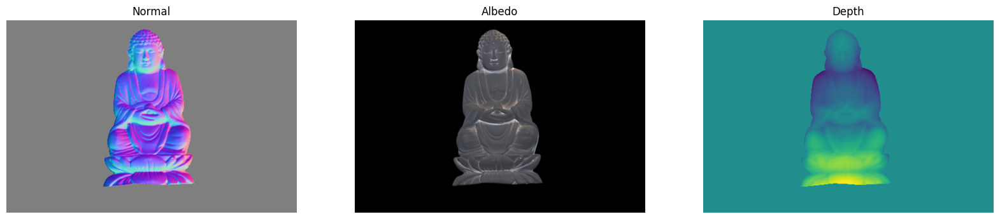

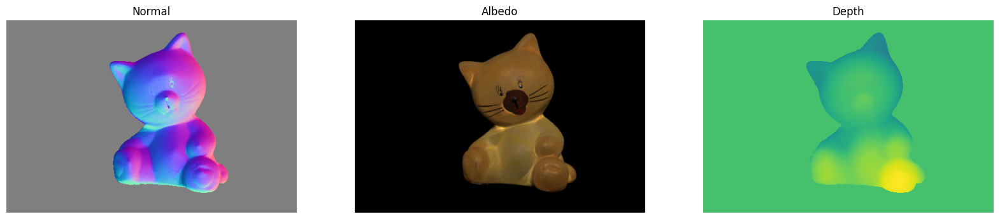

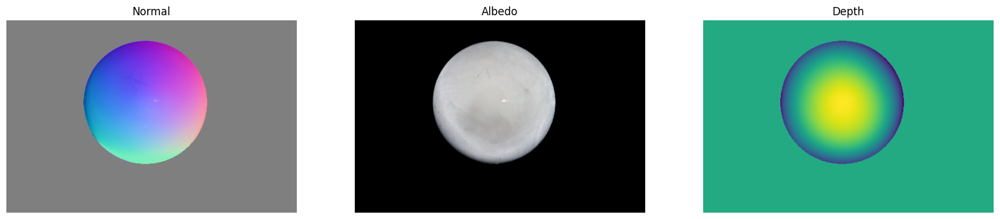

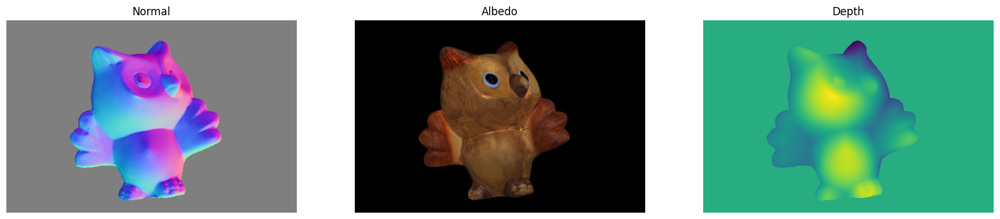

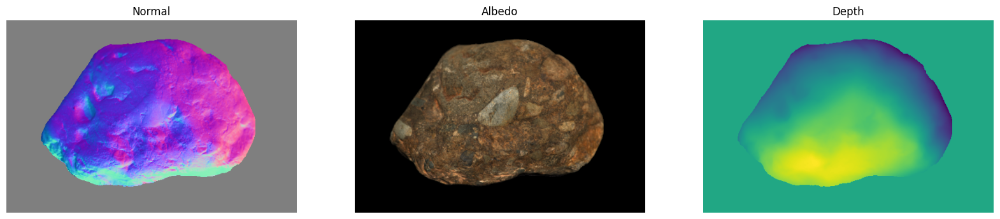

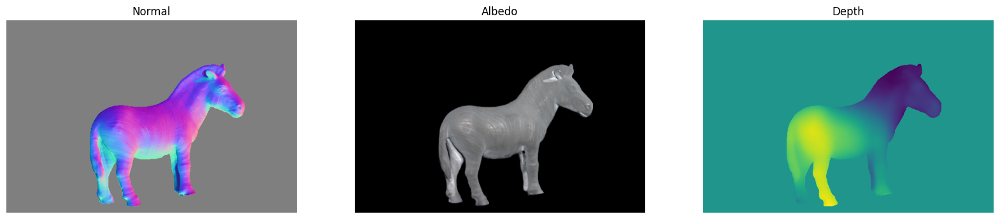

In [2]:
def comp_light(img, mask):
    """
    assume the viewer is at (0, 0, 1)
    """
    # Find the center and radius of the sphere from the mask
    ret, thresh = cv2.threshold(mask, 127, 255, 0)
    contours, _ = cv2.findContours(thresh, 1, 2)
    cnt = contours[0]
    (cx, cy), cr = cv2.minEnclosingCircle(cnt)
    # plt.imshow(cv2.circle(cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR), (int(cx), int(cy)), int(cr), (0,255,0), 2))
    # plt.show()

    # Compute a weighted average of the brightest pixel locations.
    ret, thresh = cv2.threshold(img, 230, 255, 0)
    contours, _ = cv2.findContours(thresh, 1, 2)
    cnt = contours[0]
    M = cv2.moments(cnt)
    hx = M['m10']/M['m00']
    hy = M['m01']/M['m00']
    # plt.imshow(cv2.circle(cv2.cvtColor(img, cv2.COLOR_GRAY2BGR), (int(hx), int(hy)), 3, (0, 255, 0), 1)) # plt.imshow(cv2.circle(cv2.cvtColor(img, cv2.COLOR_GRAY2BGR), (int(mx), int(my)), 3, (0, 255, 0), 1))
    # plt.show()

    # Compute surface normal at point of highlight n
    nx = (hx - cx) / cr
    ny = (hy - cy) / cr
    nz = np.sqrt(cr**2 - (hx - cx)**2 - (hy - cy)**2) / cr
    n = np.array([nx, ny, nz])

    # Compute light direction s
    r = np.array([0, 0, 1])
    s = 2 * np.dot(n, r) * n - r #.T?

    return s

def comp_normal(grays, mask, lights):
    nmap = np.zeros((mask.shape[0], mask.shape[1], 3))
    
    # Pseudo-inverse of light directions matrix
    lightDirectionsPInv = np.linalg.pinv(lights)
    
    for y in range(mask.shape[0]):
        for x in range(mask.shape[1]):
            if mask[y, x] > 0:
                # For pixel
                # Intensity values across all grayscale images
                I = np.array([grays[i][y, x] for i in range(len(lights))])
                
                # Compute normal vector
                n = np.dot(lightDirectionsPInv, I)
                
                # Normalize
                nlizer = np.linalg.norm(n)
                if nlizer > 0:  # Avoid division by zero
                    n = n / nlizer
                else:
                    n = np.array([0, 0, 1])  # else default normal
                
                nmap[y, x] = n
                
    return nmap

# output of normal map goes into this (nmap)
def comp_albedo(bgrs, mask, lights, nmap):
    amap = np.zeros((mask.shape[0], mask.shape[1], 3))
    for y in range(mask.shape[0]):
        for x in range(mask.shape[1]):
            if mask[y, x] > 0:
                # For pixel
                # Intensity values across all bgr images
                I = np.array([bgrs[i][y, x] / 255.0 for i in range(len(lights))])
                
                # Normal for current pixel
                n = nmap[y, x]
                
                # Albedo for each color channel
                for cNr in range(3):
                    Ich = I[:, cNr]
                    # least squares solution solving for albedo (p)
                    Sn = np.dot(lights, n) # light matrix and normal
        
                    if np.linalg.norm(Sn) > 0:  # Avoid division by zero
                        p = np.dot(Sn, Ich) / np.dot(Sn, Sn)
                        amap[y, x, cNr] = p
    
    # Normalize max value to 1.0
    maxVal = np.max(amap)
    if maxVal > 0:
        amap /= maxVal
    
    return amap

def comp_depth(mask, nmap):
    A = sp.lil_matrix((mask.size * 2, mask.size))
    b = np.zeros(A.shape[0])
    
    eq = 0  # Equation counter for set of linear equations of Ax = b
    for y in range(mask.shape[0]):
        for x in range(mask.shape[1]):
            if mask[y, x] > 0:
                # For pixel
                nx, ny, nz = nmap[y, x]
                
                # Next x (right neighbor)
                if x + 1 < mask.shape[1]:
                    # Constraint for x direction
                    A[eq, y * mask.shape[1] + x] = -nz
                    A[eq, y * mask.shape[1] + x + 1] = nz
                    b[eq] = -nx
                    
                    eq += 1
                    
                # Next y (bottom neighbor)
                if y + 1 < mask.shape[0]:
                    # Constraint for y direction
                    A[eq, y * mask.shape[1] + x] = -nz
                    A[eq, (y + 1) * mask.shape[1] + x] = nz
                    b[eq] = -ny
                    
                    eq += 1
                    
    # Trim A and b to avoid unnessaccary computation
    A = A[:eq]
    b = b[:eq]

    # Solve Ax=b
    AtA = A.transpose().dot(A)
    Atb = A.transpose().dot(b)
    x, info = sp.linalg.cg(AtA, Atb)
    d = x.reshape(mask.shape)
    d[mask == 0] = 0
    return d


def save_as_ply(filename, dmap, nmap, a_bgr, mask):
    Np = np.count_nonzero(mask)
    bgr = (a_bgr * 255).astype(np.uint8)
    with open(filename, 'w') as fp:
        fp.write('ply\n')
        fp.write('format ascii 1.0\n')
        fp.write('element vertex {0}\n'.format(Np))
        fp.write('property float x\n')
        fp.write('property float y\n')
        fp.write('property float z\n')
        fp.write('property float nx\n')
        fp.write('property float ny\n')
        fp.write('property float nz\n')
        fp.write('property uchar blue\n')
        fp.write('property uchar green\n')
        fp.write('property uchar red\n')
        fp.write('end_header\n')
        for y in range(dmap.shape[0]):
            for x in range(dmap.shape[1]):
                if mask[y, x] == 0:
                    continue
                fp.write('{0:e} {1:e} {2:e} {3:e} {4:e} {5:e} {6:d} {7:d} {8:d}\n'.format(x, y, dmap[y, x], nmap[y, x, 0], nmap[y, x, 1], nmap[y, x, 2], bgr[y, x, 0], bgr[y, x, 1], bgr[y, x, 2]))


# plot size
from pylab import rcParams
rcParams['figure.figsize'] = 20,20


# compute light directions
lights = np.zeros((Ni, 3))
for i in range(Ni):
    lights[i, :] = comp_light(gray['chrome'][i], mask['chrome'])

normal = {}
albedo = {}
depth = {}
for s in SUBJECT:
    if s == 'chrome':
        continue

    fig, ax = plt.subplots(1, 3)
    for a in ax:
        a.grid(False)
        a.axis('off')

    # compute normal map in [-1:1]
    n = comp_normal(gray[s], mask[s], lights)
    ax[0].imshow((n+1)/2)
    ax[0].set_title('Normal')

    # compute albedo image in [0:1]
    a_bgr = comp_albedo(bgr[s], mask[s], lights, n)
    ax[1].imshow(np.flip(a_bgr, 2))
    ax[1].set_title('Albedo')

    # compute depth image
    d = comp_depth(mask[s], n)
    ax[2].imshow(d / np.max(d))
    ax[2].set_title('Depth')

    plt.show()

    normal[s] = n
    albedo[s] = a_bgr
    depth[s] = d

    # save as ply, to render with MeshLab (http://www.meshlab.net/)
    save_as_ply('{0}.ply'.format(s), d, n, a_bgr, mask[s])



# 3D plot of depth-maps

The next cell plots the estimated depth maps by assuming that the previous cell saves the depth-maps into a dictionary named `depth`.


In [3]:
import numpy as np
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import Contours, Histogram2dContour, Marker, Scatter


def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

configure_plotly_browser_state()
init_notebook_mode(connected=False)

def plot3d(d, title):
    data = [ go.Surface(z=np.flipud(d)) ]

    layout = go.Layout(
        title=title,
        autosize=True,
        width=500,
        height=500,
        margin=dict(
            l=65,
            r=50,
            b=65,
            t=90
        )
    )

    fig = go.Figure(data=data, layout=layout)
    iplot(fig, filename=title)

for s in SUBJECT:
    if s == 'chrome':
        continue
    plot3d(depth[s], s)